# DeepForest improvement

In [2]:
import os
os.getcwd()


import pandas as pd
import ast
import numpy as np 
import networkx as nx
import geopandas as gpd
import pyproj

import matplotlib.pylab as plt
import ot
import ot.plot
import time

import datetime
import folium
from folium.map import *
from folium import plugins
from folium.plugins import MeasureControl
from folium.plugins import FloatImage

import exifread
from shapely.geometry import Polygon
import PIL
PIL.Image.MAX_IMAGE_PIXELS = None
from PIL import Image
import slidingwindow
from resizeimage import resizeimage

import lxml.etree as etree

import tensorflow

import io
import skimage.color
import skimage.io

In [7]:
from deepforest import deepforest
from deepforest import get_data
from deepforest import utilities
from deepforest import preprocess

Using TensorFlow backend.


In [8]:
os.getcwd()

'/Users/kenzaamara/Documents/ETH Zurich/Master/Master Thesis/code/oneforest/test'

In [9]:
import sys
package = os.path.dirname(os.getcwd())
sys.path.append(package)
sys.path.append(package + '/utils')
sys.path

['/anaconda3/envs/venv/lib/python36.zip',
 '/anaconda3/envs/venv/lib/python3.6',
 '/anaconda3/envs/venv/lib/python3.6/lib-dynload',
 '',
 '/Users/kenzaamara/.local/lib/python3.6/site-packages',
 '/anaconda3/envs/venv/lib/python3.6/site-packages',
 '/anaconda3/envs/venv/lib/python3.6/site-packages/IPython/extensions',
 '/Users/kenzaamara/.ipython',
 '/Users/kenzaamara/Documents/ETH Zurich/Master/Master Thesis/code/oneforest',
 '/Users/kenzaamara/Documents/ETH Zurich/Master/Master Thesis/code/oneforest/utils']

In [10]:
import utils 

from utils.citizen_science import *
from utils.deepforest_detection import *
from utils.draw_annotations import *
from utils.OT_evaluation import *
from utils.deepforest_evaluation import *
from utils.extract_features import *
from utils.merge import *
from utils.optimal_transport import *
from utils.plot import *

## DeepForest Evaluation

In [54]:
train_dir = 'deepforest/train'
test_dir = 'deepforest/test'

In [12]:
path_musacea = 'images/Flora Pluas RGB/Flora Pluas RGB_6_3800_3800_7800_7800.png'
#path_other = 'images/Carlos Vera Guevara RGB/Carlos Vera Guevara RGB_6_3800_7600_7800_11600.png'
path_other = 'images/Leonor Aspiazu RGB/Leonor Aspiazu RGB_8_7600_0_11600_4000.png'
path_mix = 'images/Nestor Macias RGB/Nestor Macias RGB_9_7600_3800_11600_7800.png' #'Flora Pluas RGB_7_3800_7600_7800_11600.png'

In [24]:
lst_type = ['mix', 'musacea', 'other']

### Resize, save

In [22]:
def resize_and_save(path_to_img, name, dir_save):
    fd_img = io.BytesIO(open(path_to_img, 'rb').read())
    
    img = Image.open(fd_img)
    img.save(os.path.join(dir_save, '{}.tif'.format(name)))
    
    img = resizeimage.resize_contain(img, [400, 400])
    img.save(os.path.join(dir_save, '{}_400.tif'.format(name)))

In [23]:
musacea = resize_and_save(path_musacea, 'musacea', train_dir)
other = resize_and_save(path_other, 'other', train_dir)
mix = resize_and_save(path_mix, 'mix', train_dir)

### True annotations

In [26]:
def resize_annotations(annotations):
    annotations[['xmin', 'ymin', 'xmax', 'ymax']] = annotations[['xmin', 'ymin', 'xmax', 'ymax']].apply(lambda x: round(x)/10, axis = 1).astype(int)
    return(annotations)
    

In [37]:
def convert_xml_to_csv(directory, name, train_on_resized = True):
    xml = get_data(os.path.join(os.getcwd(), directory,"{}.xml".format(name)))
    hand_annotations = utilities.xml_to_annotations(xml)
    hand_annotations.to_csv(os.path.join(os.getcwd(), directory,"hand_{}.csv".format(name)),index=False, header=None)
    if train_on_resized == True:
        hand_annotations = resize_annotations(hand_annotations)
    return hand_annotations

In [68]:
hand_train = pd.DataFrame()
for name in lst_type:
    #convert hand annotations from xml into retinanet format
    train_annotations = convert_xml_to_csv(train_dir, name, train_on_resized = False)
    hand_train = pd.concat([hand_train, train_annotations])
    
#Write converted dataframe to file. Saved alongside the images
path = os.path.join(train_dir, "hand_annotations_train.csv")
hand_train.to_csv(path,index=False, header=None)

In [3]:
df1 = pd.read_csv("deepforest/train/hand_annotations_train.csv")
df2 = pd.read_csv("deepforest/test/hand_test_example.csv")
len(df1), len(df2)

(324, 103)

### DeepForest (old version) annotations

In [34]:
#Load the latest release
old_model = deepforest.deepforest()
old_model.use_release()

Reading config file: /anaconda3/envs/venv/lib/python3.6/site-packages/deepforest/data/deepforest_config.yml
A blank deepforest object created. To perform prediction, either train or load an existing model.
Model from DeepForest release https://github.com/weecology/DeepForest/releases/tag/v0.3.0 was already downloaded. Loading model from file.
Loading pre-built model: https://github.com/weecology/DeepForest/releases/tag/v0.3.0

tracking <tf.Variable 'Variable:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_1:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_2:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_3:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_4:0' shape=(9, 4) dtype=float32> anchors
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


### Evaluation of DeepForest old version on Training Set

In [41]:
for name in lst_type:
    file_path = os.path.join(os.getcwd(), train_dir, '{}.tif'.format(name))
    annot = get_annotations(file_path, old_model)
    annot.to_csv(os.path.join(train_dir, 'df_old_{}.csv'.format(name)))

Precision for mix:  0.6428571428571429
Recall for mix:  0.11764705882352941


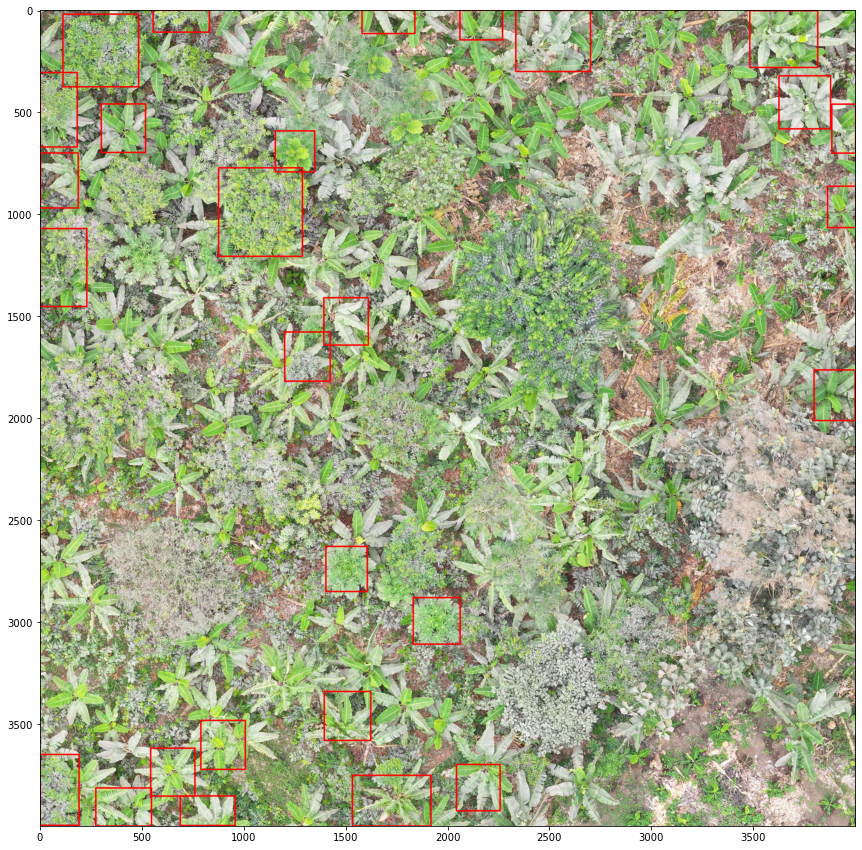

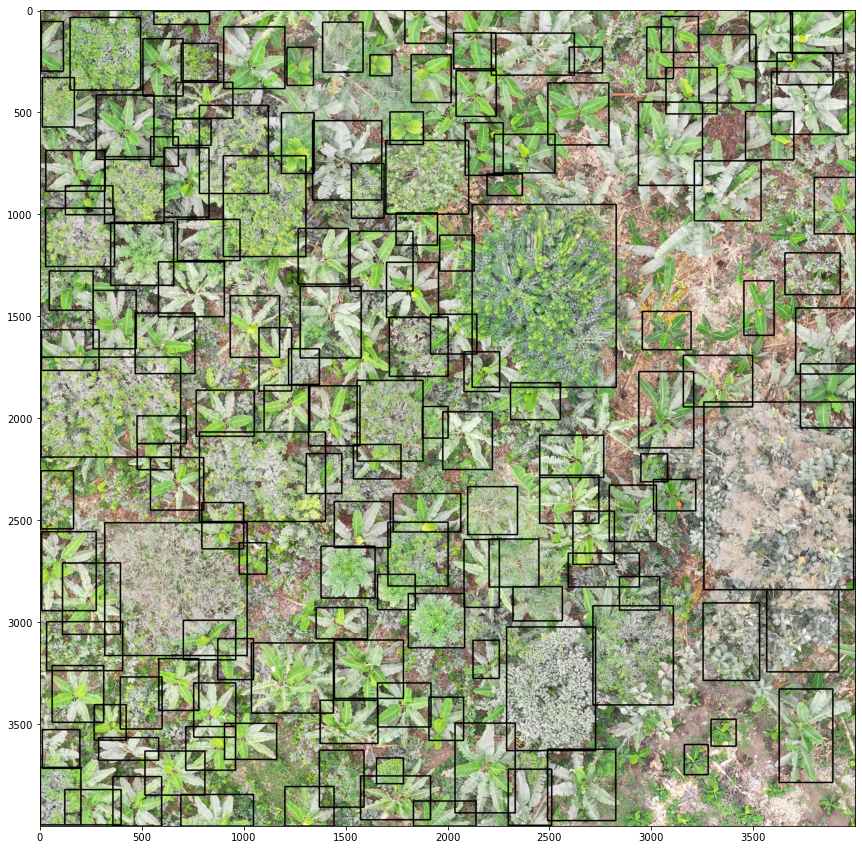

Precision for musacea:  0.29310344827586204
Recall for musacea:  0.2698412698412698


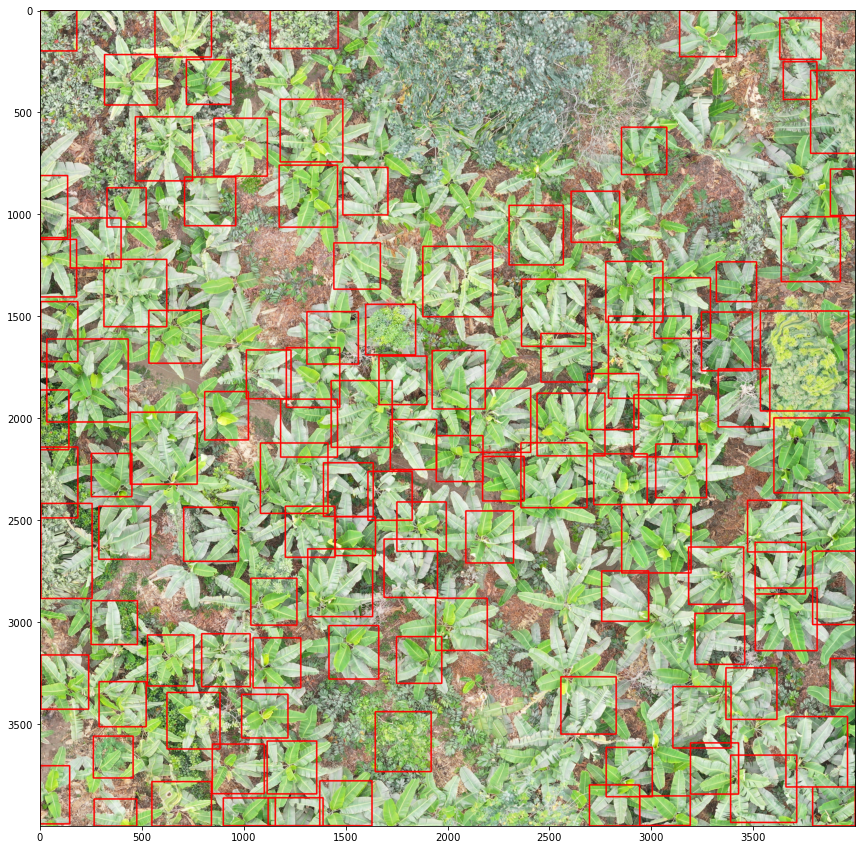

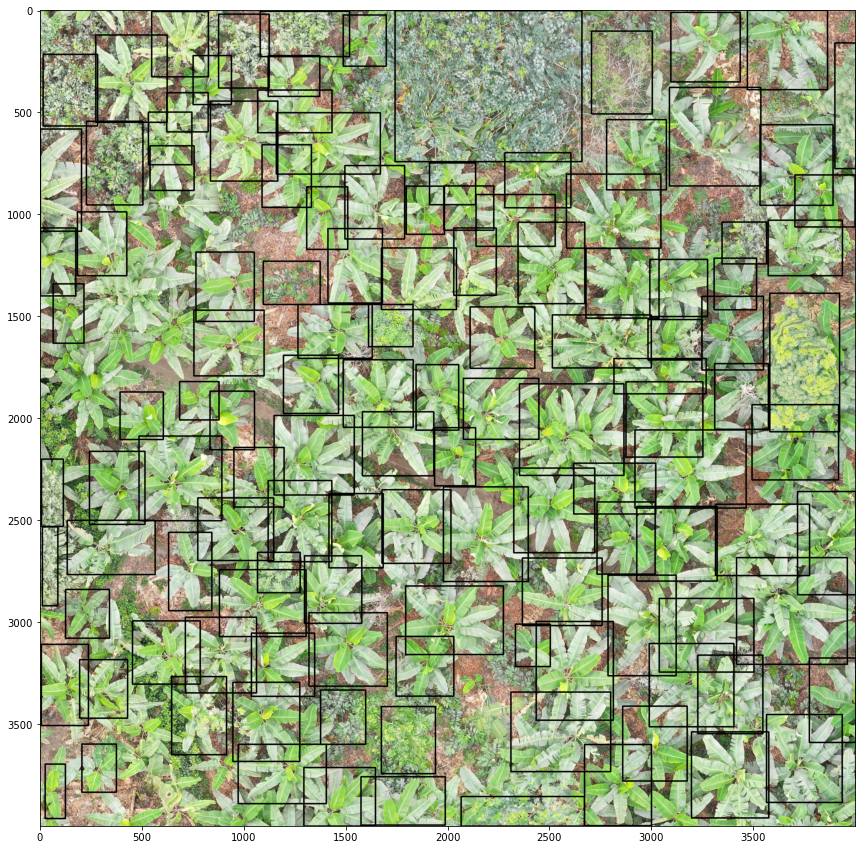

Precision for other:  0.44680851063829785
Recall for other:  0.45652173913043476


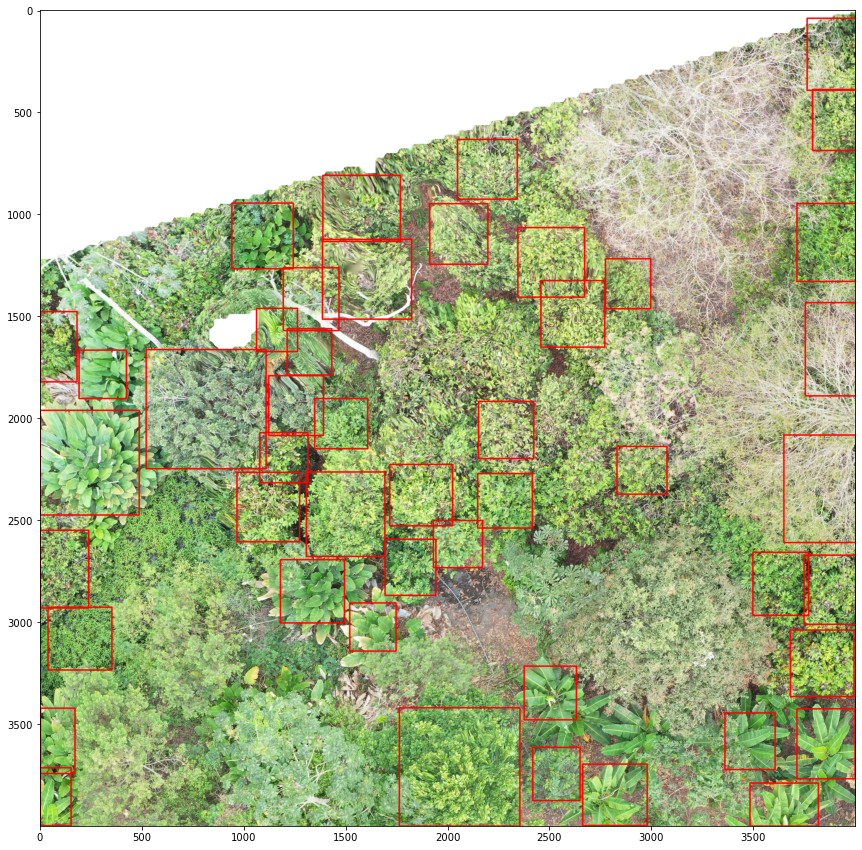

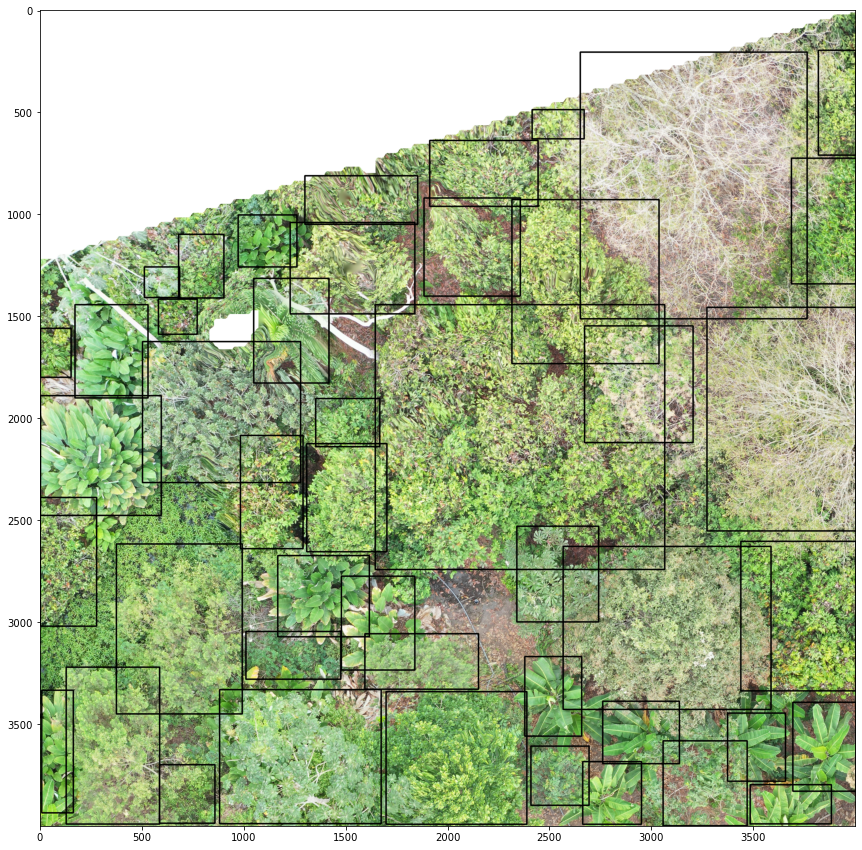

In [48]:
for name in lst_type:
    deepforest_annot = pd.read_csv(os.path.join(train_dir, 'df_old_{}.csv'.format(name)))
    hand_annot = pd.read_csv(os.path.join(train_dir, 'hand_{}.csv'.format(name)), names=['img_path', 'xmin', "ymin", "xmax", "ymax", 'label'])
    X_pred = deepforest_annot[["xmin", "ymin", "xmax", "ymax"]].to_numpy()
    X_true = hand_annot[["xmin", "ymin", "xmax", "ymax"]].to_numpy()
              
    res = evaluate_iou(X_pred, X_true)
    print('Precision for {}: '.format(name), precision(res))
    print('Recall for {}: '.format(name), recall(res, X_true))
         
        
    path = os.path.join(train_dir, '{}.tif'.format(name))

    bboxes = box_to_annotation(X_pred)
    plt.figure(figsize=(15,15))
    im = cv2.imread(path)
    im = draw_annotations(im, bboxes, color=(0, 0, 255), label_to_name=None, cv2_authorized = False, thickness = 5)
    plt.show()
    
    
    bboxes = box_to_annotation(X_true)
    plt.figure(figsize=(15,15))
    im = cv2.imread(path)
    im = draw_annotations(im, bboxes, color=(0,0,0), label_to_name=None, cv2_authorized = False, thickness = 5)
    plt.show()




### Evaluation of DeepForest old version on Testing Set

In [111]:
name = 'test_example'
path_test_example = 'images/Flora Pluas RGB/Flora Pluas RGB_7_3800_7600_7800_11600.png'

In [112]:
resize_and_save(path_test_example, 'test_example', test_dir)

In [113]:
test_annotations = convert_xml_to_csv(test_dir, name, train_on_resized = False)

In [114]:
file_path = os.path.join(os.getcwd(), test_dir, '{}.tif'.format(name))
annot = get_annotations(file_path, old_model)
annot.to_csv(os.path.join(test_dir, 'df_old_{}.csv'.format(name)))

Precision for test_example:  0.25
Recall for test_example:  0.2403846153846154


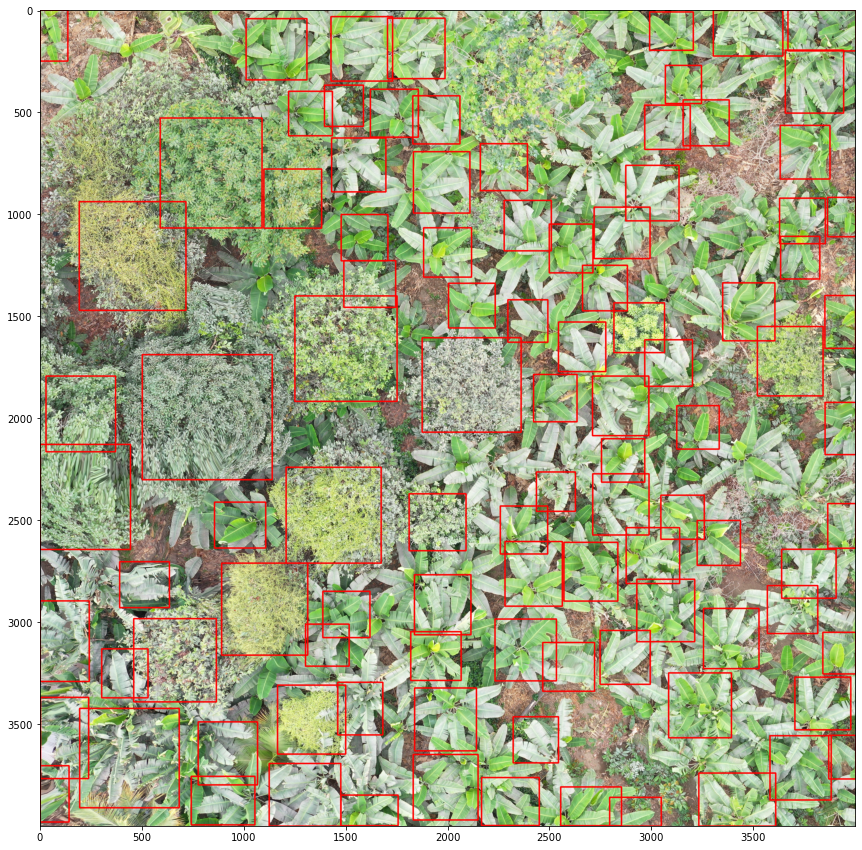

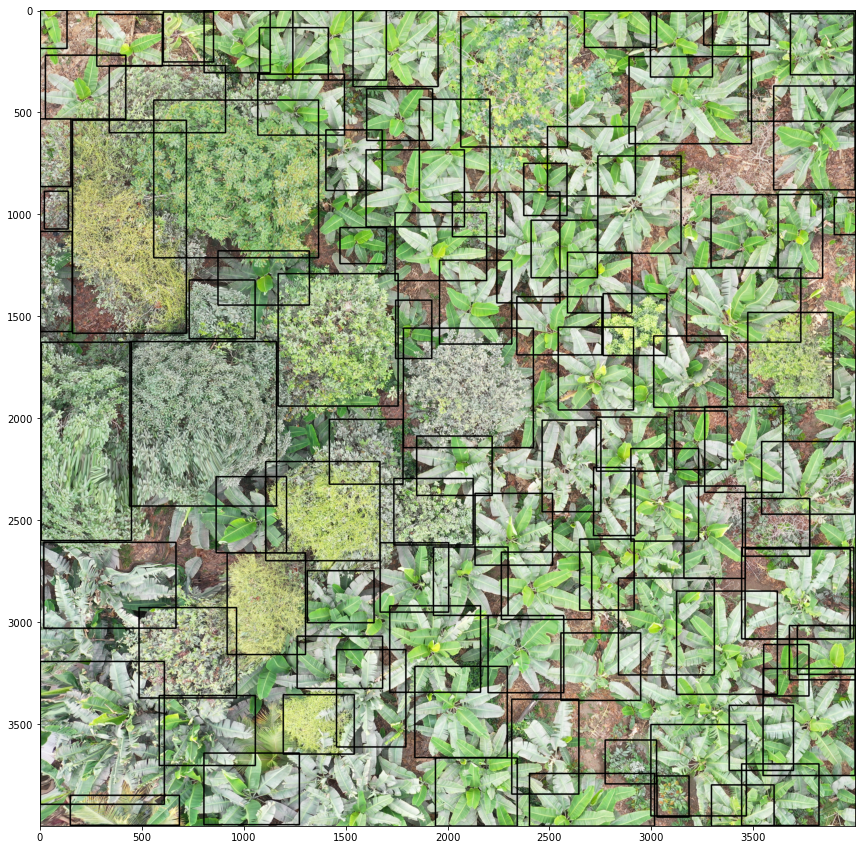

In [115]:
deepforest_annot = pd.read_csv(os.path.join(test_dir, 'df_old_{}.csv'.format(name)))
hand_annot = pd.read_csv(os.path.join(test_dir, 'hand_{}.csv'.format(name)), names=['img_path', 'xmin', "ymin", "xmax", "ymax", 'label'])
X_pred = deepforest_annot[["xmin", "ymin", "xmax", "ymax"]].to_numpy()
X_true = hand_annot[["xmin", "ymin", "xmax", "ymax"]].to_numpy()

res = evaluate_iou(X_pred, X_true)
print('Precision for {}: '.format(name), precision(res))
print('Recall for {}: '.format(name), recall(res, X_true))


path = os.path.join(test_dir, '{}.tif'.format(name))

bboxes = box_to_annotation(X_pred)
plt.figure(figsize=(15,15))
im = cv2.imread(path)
im = draw_annotations(im, bboxes, color=(0, 0, 255), label_to_name=None, cv2_authorized = False, thickness = 5)
plt.show()


bboxes = box_to_annotation(X_true)
plt.figure(figsize=(15,15))
im = cv2.imread(path)
im = draw_annotations(im, bboxes, color=(0,0,0), label_to_name=None, cv2_authorized = False, thickness = 5)
plt.show()

## DeepForest Finetuning

Train DeepForest on images of Ecudaor sites.

### Training DeepForest

In [96]:
#Write window annotations file without a header row, same location as the "base_dir" above.
annotations_file_train= os.path.join(train_dir, "hand_annotations_train.csv")

#Load the latest release
model = deepforest.deepforest()
model.use_release()

# Example run with short training
model.config["batch_size"] = 5
model.config["epochs"] = 35
model.config["save-snapshot"] = False
model.train(annotations=annotations_file_train, input_type="fit_generator", comet_experiment = None)

#save trained model
model.model.save("deepforest/final_model_4000_epochs_35.h5")


Reading config file: /anaconda3/envs/venv/lib/python3.6/site-packages/deepforest/data/deepforest_config.yml
A blank deepforest object created. To perform prediction, either train or load an existing model.
Model from DeepForest release https://github.com/weecology/DeepForest/releases/tag/v0.3.0 was already downloaded. Loading model from file.
Loading pre-built model: https://github.com/weecology/DeepForest/releases/tag/v0.3.0
tracking <tf.Variable 'Variable_65:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_66:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_67:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_68:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_69:0' shape=(9, 4) dtype=float32> anchors
There are 1 unique labels: ['Tree'] 
Disabling snapshot saving
Training retinanet with the following args ['--weights', '/anaconda3/envs/venv/lib/python3.6/site-packages/deepforest/data/NEON.h5', '--b

Epoch 1/35
1/1 [==============================] - 54s 54s/step - loss: 2.8169 - regression_loss: 2.3076 - classification_loss: 0.5094
Epoch 2/35
1/1 [==============================] - 48s 48s/step - loss: 2.7090 - regression_loss: 2.2440 - classification_loss: 0.4651
Epoch 3/35
1/1 [==============================] - 44s 44s/step - loss: 2.6155 - regression_loss: 2.1895 - classification_loss: 0.4260
Epoch 4/35
1/1 [==============================] - 41s 41s/step - loss: 2.5649 - regression_loss: 2.1679 - classification_loss: 0.3970
Epoch 5/35
1/1 [==============================] - 44s 44s/step - loss: 2.5167 - regression_loss: 2.1436 - classification_loss: 0.3731
Epoch 6/35
1/1 [==============================] - 43s 43s/step - loss: 2.4869 - regression_loss: 2.1338 - classification_loss: 0.3531
Epoch 7/35
1/1 [==============================] - 46s 46s/step - loss: 2.4786 - regression_loss: 2.1313 - classification_loss: 0.3473
Epoch 8/35
1/1 [==============================] - 44s 44s/step

In [90]:
mAP = model.evaluate_generator(annotations=annotations_file_train)
print("Mean Average Precision is: {:.3f}".format(mAP))

Running network: N/A% (0 of 3) |         | Elapsed Time: 0:00:00 ETA:  --:--:--

There are 1 unique labels: ['Tree'] 
Disabling snapshot saving


Running network: 100% (3 of 3) |#########| Elapsed Time: 0:00:21 Time:  0:00:21
Parsing annotations: 100% (3 of 3) |#####| Elapsed Time: 0:00:00 Time:  0:00:00


325 instances of class Tree with average precision: 0.4988
mAP using the weighted average of precisions among classes: 0.4988
mAP: 0.4988
Mean Average Precision is: 0.499


<Figure size 720x2160 with 0 Axes>

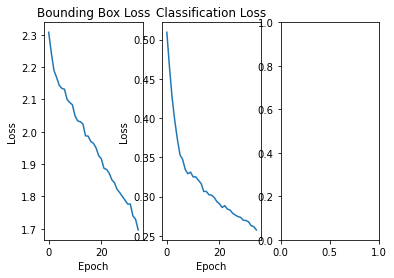

In [106]:
plt.figure(figsize=(10,30))
model.plot_curves()

### Choose new model of DeepForest

In [107]:
model = deepforest.deepforest(saved_model = os.getcwd()+'/deepforest/final_model_4000_epochs_35.h5')

Reading config file: /anaconda3/envs/venv/lib/python3.6/site-packages/deepforest/data/deepforest_config.yml
Loading saved model
tracking <tf.Variable 'Variable_75:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_76:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_77:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_78:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_79:0' shape=(9, 4) dtype=float32> anchors


### Evaluation of DeepForest tuned on Training Set

In [91]:
for name in lst_type:
    file_path = os.path.join(os.getcwd(), train_dir, '{}.tif'.format(name))
    annot = get_annotations(file_path, model)
    annot.to_csv(os.path.join(train_dir, 'df_tuned_{}.csv'.format(name)))

Precision for mix:  0.48
Recall for mix:  0.47058823529411764


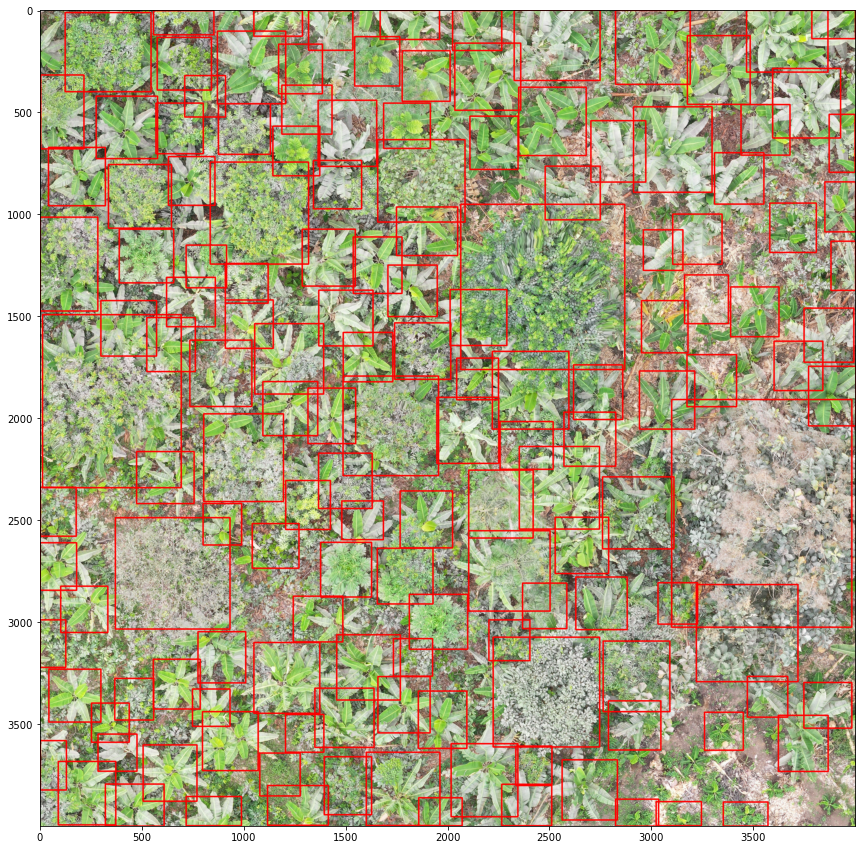

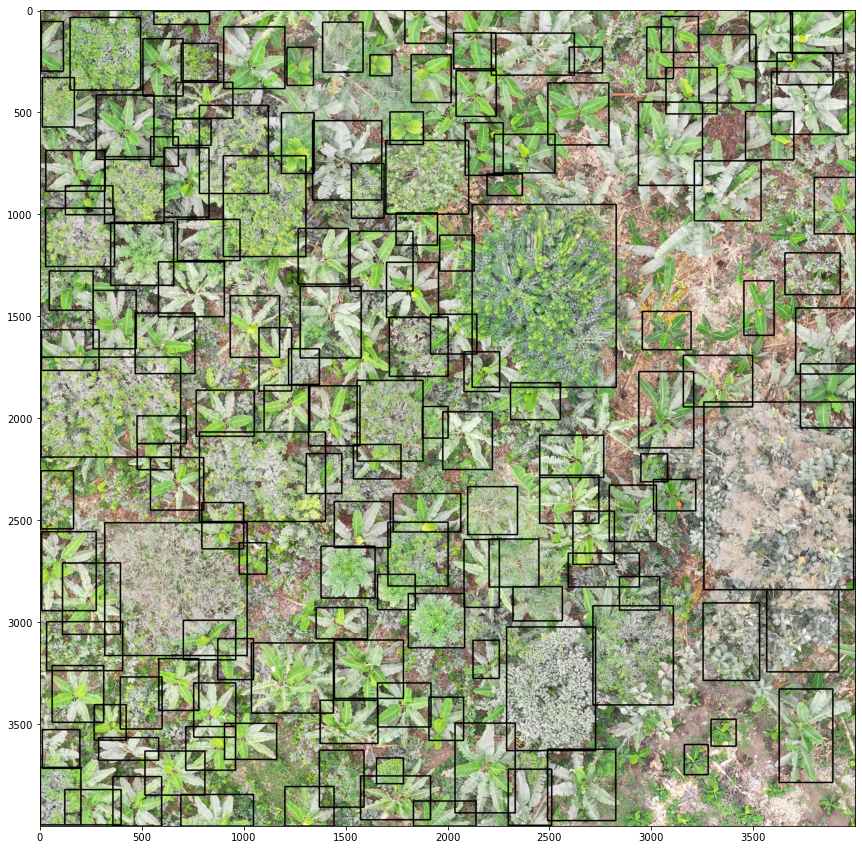

Precision for musacea:  0.5741935483870968
Recall for musacea:  0.7063492063492064


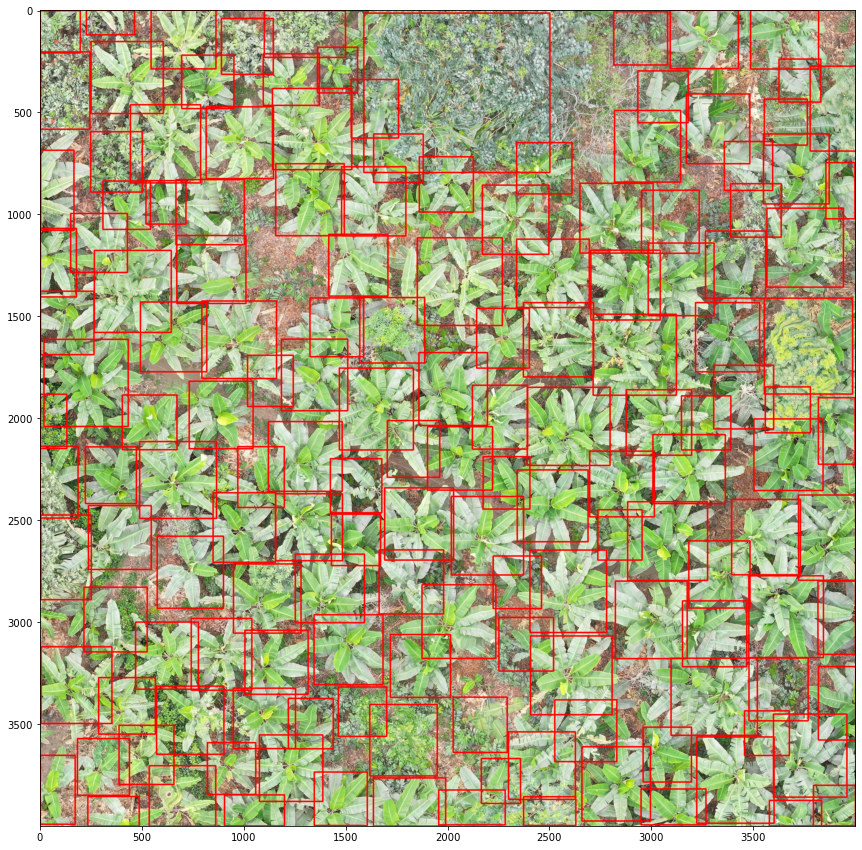

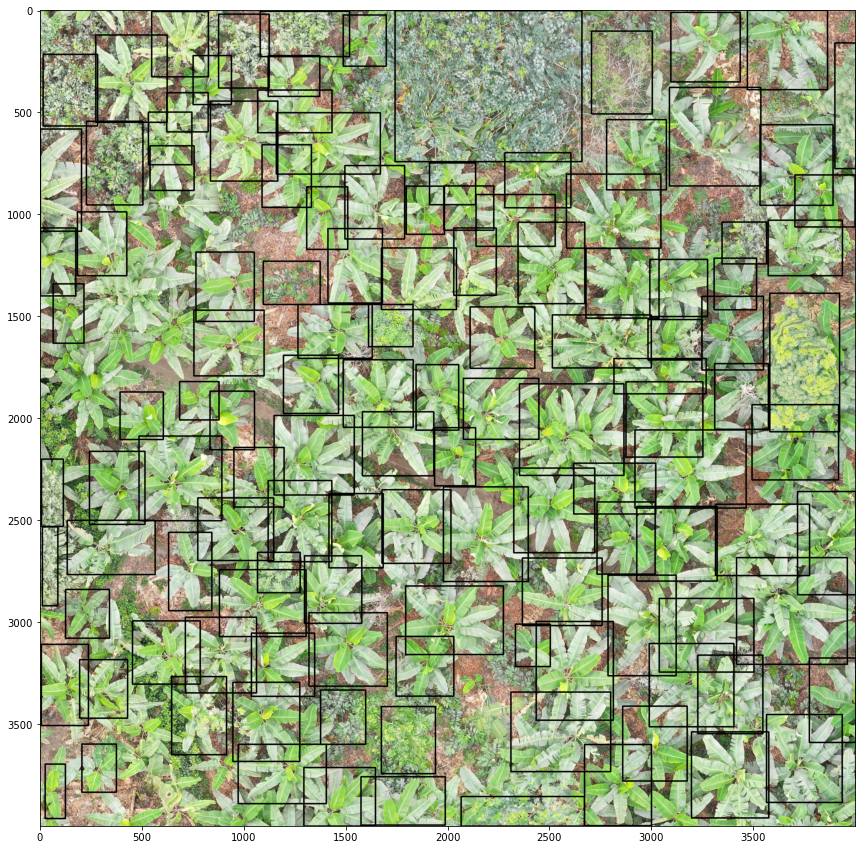

Precision for other:  0.6031746031746031
Recall for other:  0.8260869565217391


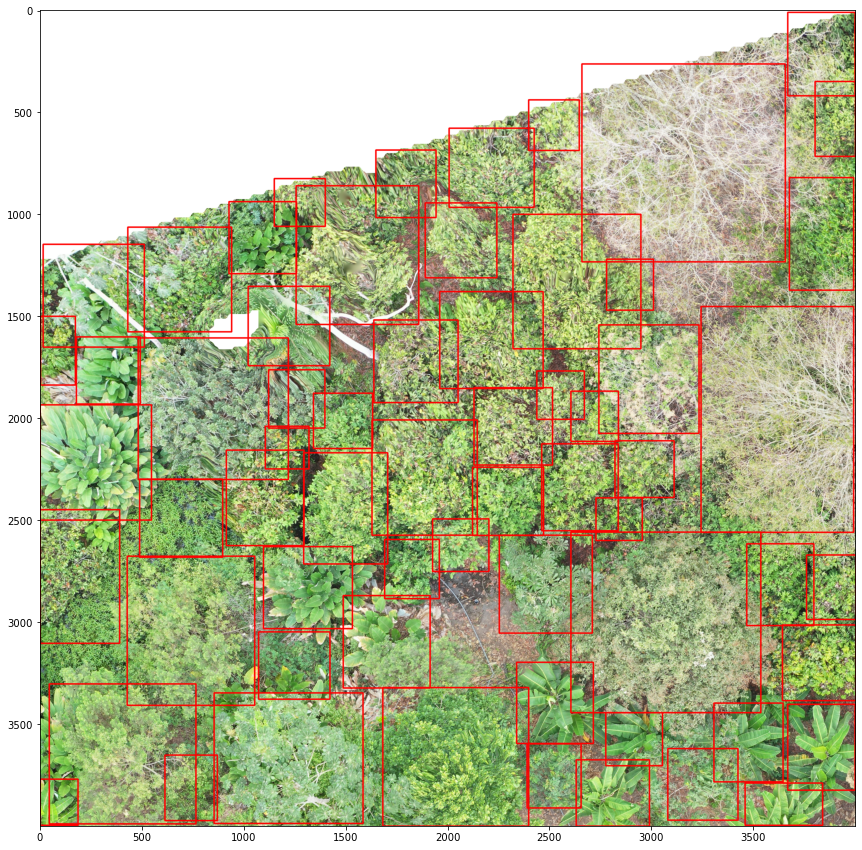

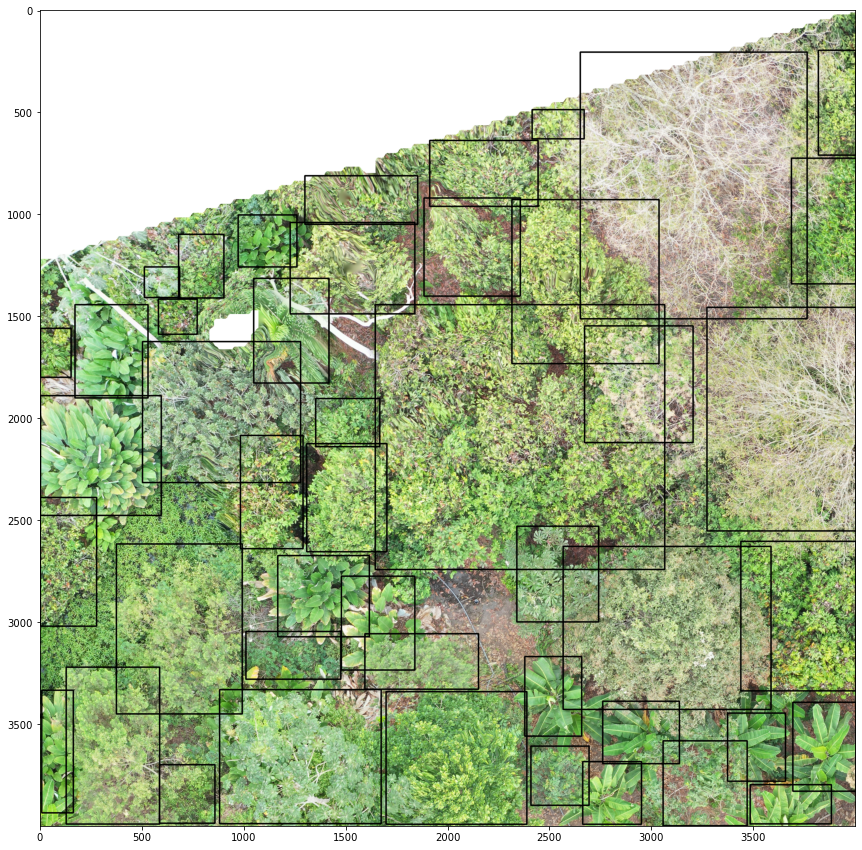

In [92]:
for name in lst_type:
    deepforest_annot = pd.read_csv(os.path.join(train_dir, 'df_tuned_{}.csv'.format(name)))
    hand_annot = pd.read_csv(os.path.join(train_dir, 'hand_{}.csv'.format(name)), names=['img_path', 'xmin', "ymin", "xmax", "ymax", 'label'])
    X_pred = deepforest_annot[["xmin", "ymin", "xmax", "ymax"]].to_numpy()
    X_true = hand_annot[["xmin", "ymin", "xmax", "ymax"]].to_numpy()
              
    res = evaluate_iou(X_pred, X_true)
    print('Precision for {}: '.format(name), precision(res))
    print('Recall for {}: '.format(name), recall(res, X_true))
         
        
    path = os.path.join(train_dir, '{}.tif'.format(name))

    bboxes = box_to_annotation(X_pred)
    plt.figure(figsize=(15,15))
    im = cv2.imread(path)
    im = draw_annotations(im, bboxes, color=(0, 0, 255), label_to_name=None, cv2_authorized = False, thickness = 5)
    plt.show()
    
    
    bboxes = box_to_annotation(X_true)
    plt.figure(figsize=(15,15))
    im = cv2.imread(path)
    im = draw_annotations(im, bboxes, color=(0,0,0), label_to_name=None, cv2_authorized = False, thickness = 5)
    plt.show()


### Evaluation of DeepForest tuned on Testing Set

In [108]:
name = 'test_example'

In [109]:
file_path = os.path.join(os.getcwd(), test_dir, '{}.tif'.format(name))
annot = get_annotations(file_path, model)
annot.to_csv(os.path.join(test_dir, 'df_tuned_{}.csv'.format(name)))

     Unnamed: 0          img_path         xmin         ymin         xmax  \
0             0  test_example.tif  1849.815308  1580.732056  2389.253418   
1             1  test_example.tif   873.165283  2696.398682  1311.784790   
2             2  test_example.tif  1205.819336  2193.970459  1711.102295   
3             3  test_example.tif  1204.485107  1355.417725  1764.561035   
4             4  test_example.tif  1150.976440  3293.892578  1505.584229   
..          ...               ...          ...          ...          ...   
146         146  test_example.tif  2082.604248  2917.302002  2280.219727   
147         147  test_example.tif   113.960640   813.828552   400.905121   
148         148  test_example.tif  2467.224854  3637.248535  2672.665771   
149         149  test_example.tif  3874.491455  3550.331055  3999.137207   
150         150  test_example.tif  2989.613525  1571.221924  3206.312256   

            ymax     score  
0    2080.978271  0.734661  
1    3179.482178  0.718570  


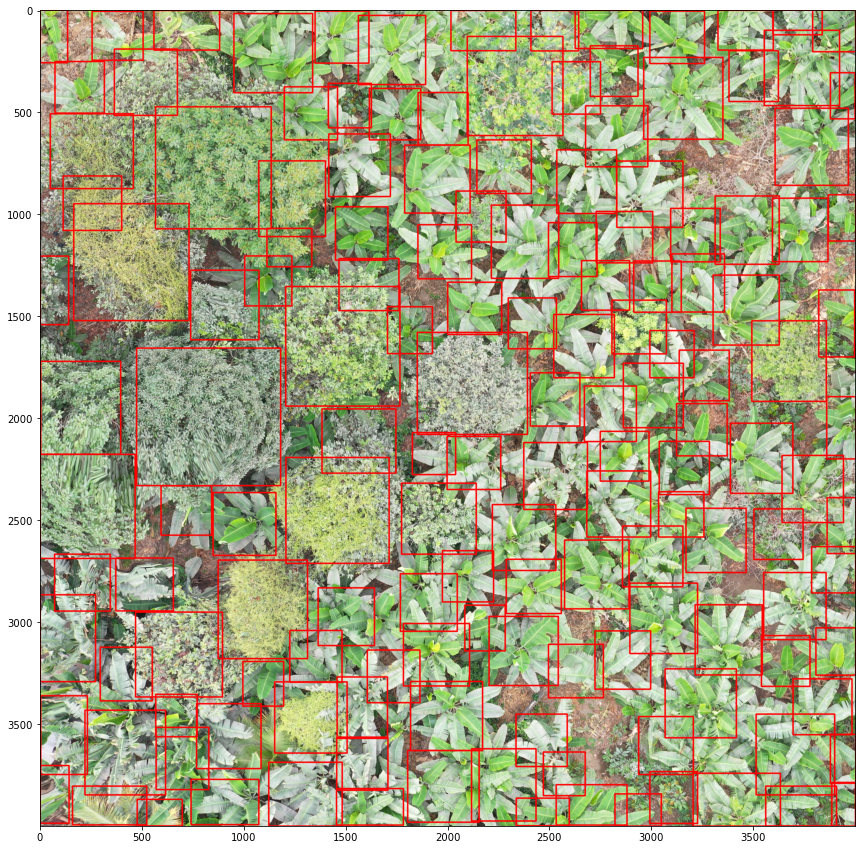

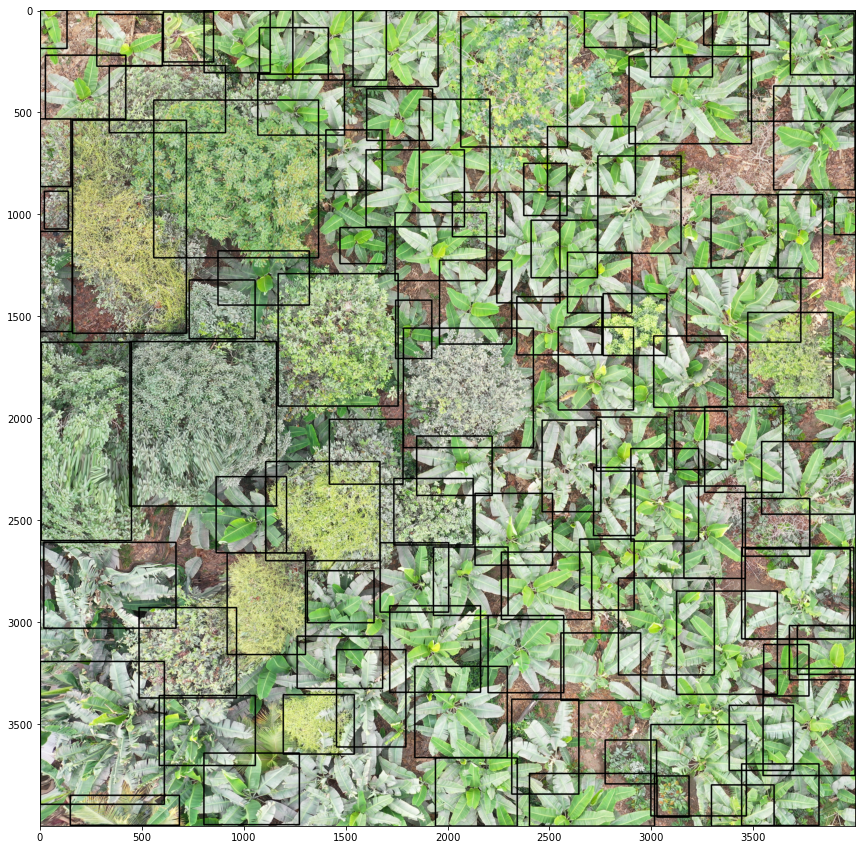

In [110]:
deepforest_annot = pd.read_csv(os.path.join(test_dir, 'df_tuned_{}.csv'.format(name)))
hand_annot = pd.read_csv(os.path.join(test_dir, 'hand_{}.csv'.format(name)), names=['img_path', 'xmin', "ymin", "xmax", "ymax", 'label'])

print(deepforest_annot)
print(hand_annot)
X_pred = deepforest_annot[["xmin", "ymin", "xmax", "ymax"]].to_numpy()
X_true = hand_annot[["xmin", "ymin", "xmax", "ymax"]].to_numpy()

res = evaluate_iou(X_pred, X_true)
print('Precision for {}: '.format(name), precision(res))
print('Recall for {}: '.format(name), recall(res, X_true))


path = os.path.join(test_dir, '{}.tif'.format(name))

bboxes = box_to_annotation(X_pred)
plt.figure(figsize=(15,15))
im = cv2.imread(path)
im = draw_annotations(im, bboxes, color=(0, 0, 255), label_to_name=None, cv2_authorized = False, thickness = 5)
plt.show()


bboxes = box_to_annotation(X_true)
plt.figure(figsize=(15,15))
im = cv2.imread(path)
im = draw_annotations(im, bboxes, color=(0,0,0), label_to_name=None, cv2_authorized = False, thickness = 5)
plt.show()


## Visualize DeepForest Before and After

In [116]:
tile = input('Choose a tile: ')

Choose a tile: Flora Pluas RGB_5_3800_0_7800_4000.png


In [121]:
file_path = os.getcwd() + '/images/{}/{}'.format(tile.split('_')[0], tile)
print(file_path)

deepforest_annot_old = get_annotations(file_path, old_model)
X_pred_old = deepforest_annot_old[["xmin", "ymin", "xmax", "ymax"]].to_numpy()

deepforest_annot_new = get_annotations(file_path, model)
X_pred_new = deepforest_annot_new[["xmin", "ymin", "xmax", "ymax"]].to_numpy()

/Users/kenzaamara/Documents/ETH Zurich/Master/Master Thesis/code/oneforest/test/images/Flora Pluas RGB/Flora Pluas RGB_5_3800_0_7800_4000.png


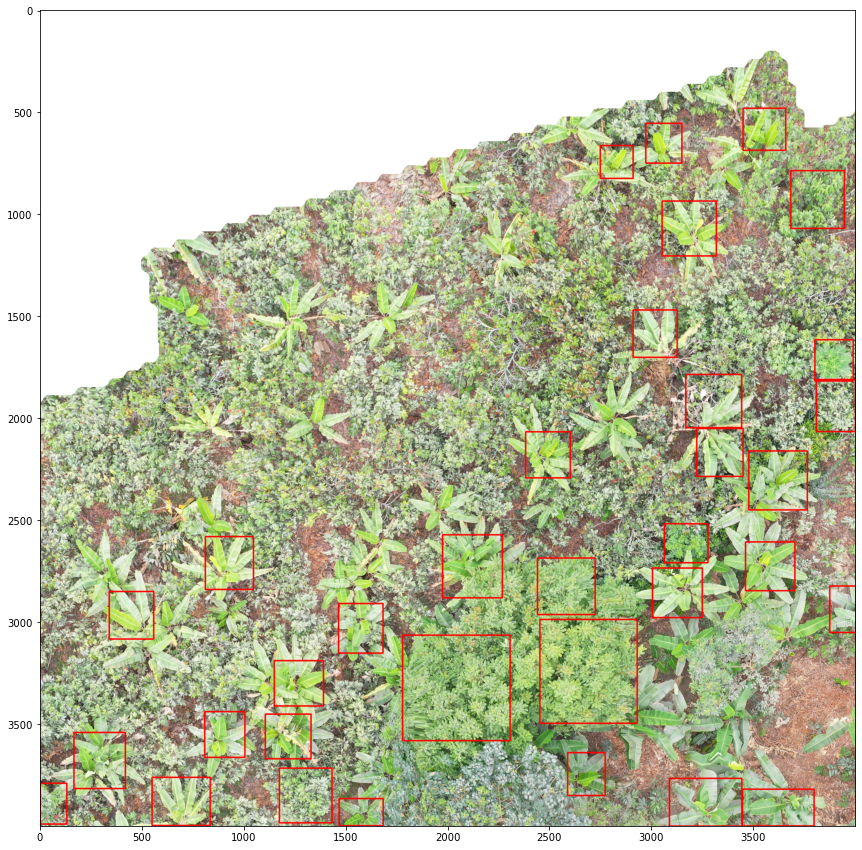

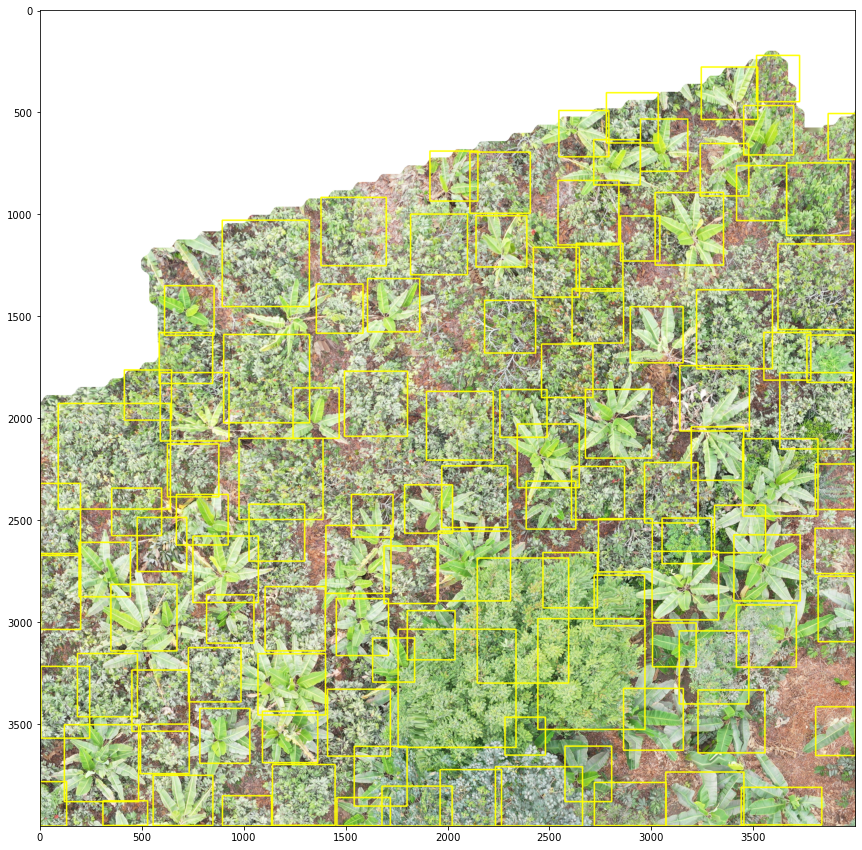

In [122]:
bboxes = box_to_annotation(X_pred_old)
plt.figure(figsize=(15,15))
im = cv2.imread(file_path)
im = draw_annotations(im, bboxes, color=(0, 0, 255), label_to_name=None, cv2_authorized = False, thickness = 5)
plt.show()


bboxes = box_to_annotation(X_pred_new)
plt.figure(figsize=(15,15))
im = cv2.imread(file_path)
im = draw_annotations(im, bboxes, color=(0,255,255), label_to_name=None, cv2_authorized = False, thickness = 5)
plt.show()